<a href="https://colab.research.google.com/github/Yashmalhotra98/Sign-Language-interpreter/blob/main/Copy_of_sign_language_photo_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
tf.__version__

# Importing the dataset
train = pd.read_csv('/content/sign_mnist_train.csv')
test = pd.read_csv('/content/sign_mnist_test.csv')

# Splitting the dataset to get the categorical variable
X_train = train.iloc[:, 1:].values
y_train = train.iloc[:, 0].values

X_test = test.iloc[:, 1:].values
y_test = test.iloc[:, 0].values

# Reshaping the independent values into 28x28 pixel groups
X_train = np.array([np.reshape(i, (28,28)) for i in X_train])
X_test = np.array([np.reshape(i, (28,28)) for i in X_test])

# Reshaping the dependant variable
y_train = np.array(y_train).reshape(-1)
y_test = np.array(y_test).reshape(-1)

# Encoding categorical data
y_train = tf.keras.utils.to_categorical(y_train, 26)
y_test = tf.keras.utils.to_categorical(y_test, 26)

X_train = X_train.reshape((27455, 28, 28,1))
X_test = X_test.reshape((7172, 28, 28,1))

# Building the CNN

# Initialising the CNN
classifier = tf.keras.models.Sequential()

# Step 1 - Convolution
classifier.add(tf.keras.layers.Conv2D(filters=32, kernel_size=3, padding="same", activation="relu", input_shape=[28, 28, 1]))

# Step 2 - Pooling
classifier.add(tf.keras.layers.MaxPool2D(pool_size=2))

# Adding a second convolutional layer
classifier.add(tf.keras.layers.Conv2D(filters=64, kernel_size=3, padding="same", activation="relu"))
classifier.add(tf.keras.layers.MaxPool2D(pool_size=2))

# Adding a third convolutional layer
classifier.add(tf.keras.layers.Conv2D(filters=128, kernel_size=3, padding="same", activation="relu"))
classifier.add(tf.keras.layers.MaxPool2D(pool_size=2))

# Adding a forth convolutional layer
classifier.add(tf.keras.layers.Conv2D(filters=128, kernel_size=3, padding="same", activation="relu"))
classifier.add(tf.keras.layers.MaxPool2D(pool_size=2))

# Adding Dropout
classifier.add(tf.keras.layers.Dropout(0.2))

# Step 3 - Flattening
classifier.add(tf.keras.layers.Flatten())

# Step 4 - Full Connection
classifier.add(tf.keras.layers.Dense(units=128, activation='relu'))

# Step 5 - Output Layer
classifier.add(tf.keras.layers.Dense(units=26, activation='softmax'))

# Training the CNN

# Compiling the CNN
classifier.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics = ['accuracy'])

# Training the CNN on the Training set
history = classifier.fit(X_train, y_train, validation_split=0.33, batch_size = 64, epochs = 50, verbose=0)

# Evaluating the accuracy
accuracy = classifier.evaluate(X_test, y_test)
print("Accuracy: ", accuracy[1])

# Saving the CNN Model
classifier.save('CNN_Model.h5')

# Predicting Test set results
y_pred = classifier.predict(X_test)

classifier.summary()



plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0.5, 1])
plt.legend(loc='lower right')

FileNotFoundError: ignored

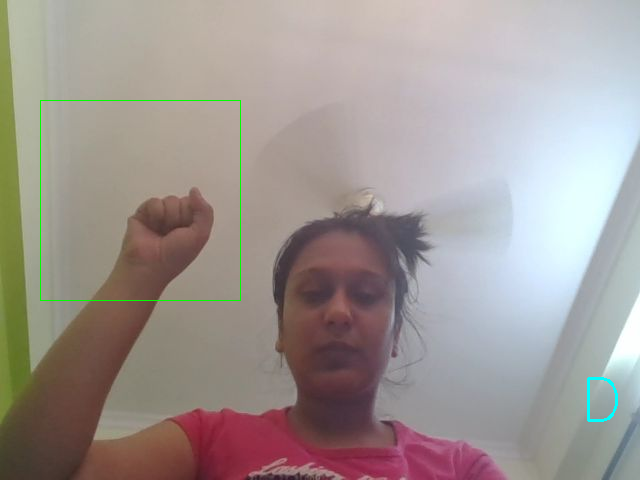

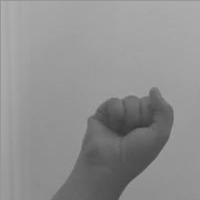

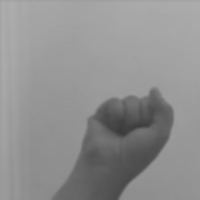

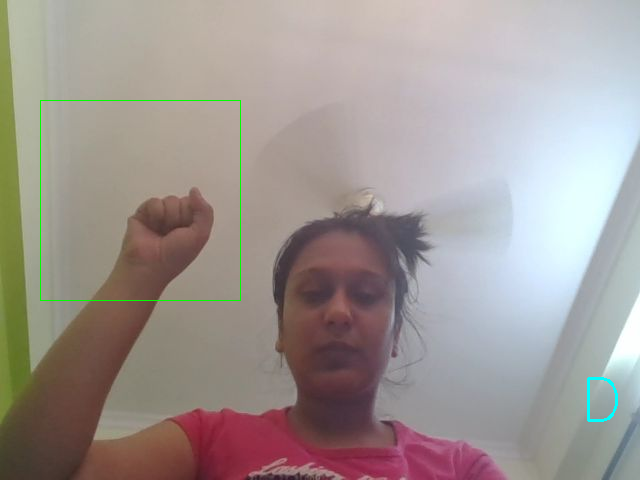

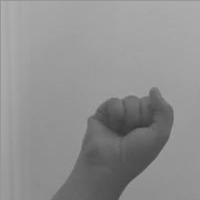

...

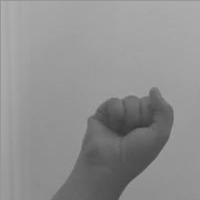

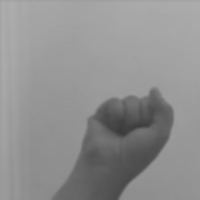

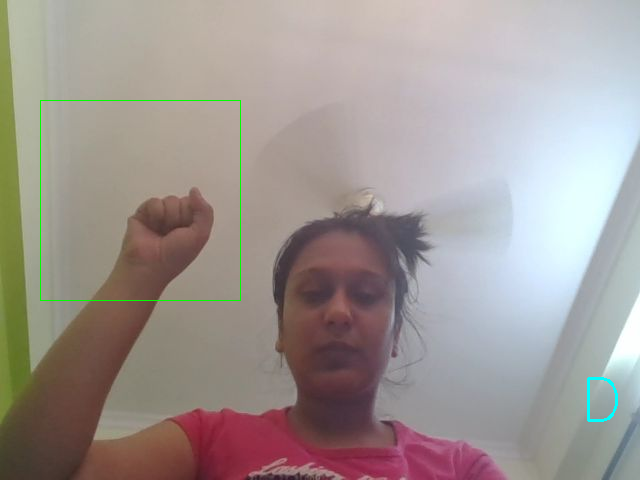

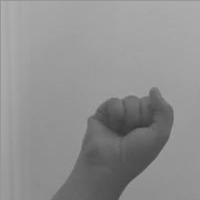

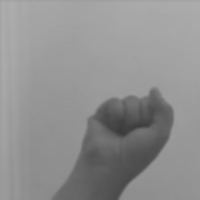

In [ ]:
import numpy as np
import cv2
import tensorflow as tf
from google.colab.patches import cv2_imshow
model = tf.keras.models.load_model("/content/CNN_Model.h5")

def img_class(model, img):
    img_arr = np.asarray(img)
    
    pred_probab = model.predict(img_arr)[0]
    pred_class = list(pred_probab).index(max(pred_probab))
    return max(pred_probab), pred_class


# Initializing Video Frame

cap=cv2.imread("/content/photo.jpg")
while(True):
    # Capture frame-by-frame
    
    frame=cap
    # Our operations on the frame come here
    # Displaying border in frame
    frame = cv2.rectangle(frame, (40,100), (240,300), (0,255,0), thickness = 1)
    
    # Cropping Hand Region
    crop = frame[100:300, 40:240]
    
    # Converting to GRAY
    img_gry = cv2.cvtColor(crop, cv2.COLOR_BGR2GRAY)
    
    # Applying Gaussian BLur                       
    img_gry_blr = cv2.GaussianBlur(img_gry, (5,5), 0)
    
    # Resizing
    img_1 = cv2.resize(img_gry_blr, (28,28), interpolation = cv2.INTER_AREA)
    img_2 = np.resize(img_1, (28,28,1))
    img_3 = np.expand_dims(img_2, axis = 0)
    
        
    pred_probab, pred_class = img_class(model, img_3)
    
    char_op = chr(pred_class + 65)

    cv2.putText(frame, char_op, (580,420), cv2.FONT_HERSHEY_SIMPLEX, 2, (255,255,0), 2)

    # Display the resulting frame
    cv2_imshow(frame)
    cv2_imshow(img_gry)
    cv2_imshow(img_gry_blr)
    
    if cv2.waitKey(25) & 0xFF == ord('q'):
        break

# When everything done, release the capture
cap.release()
cv2.destroyAllWindows()

In [ ]:

from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

<IPython.core.display.Javascript object>

Saved to photo.jpg


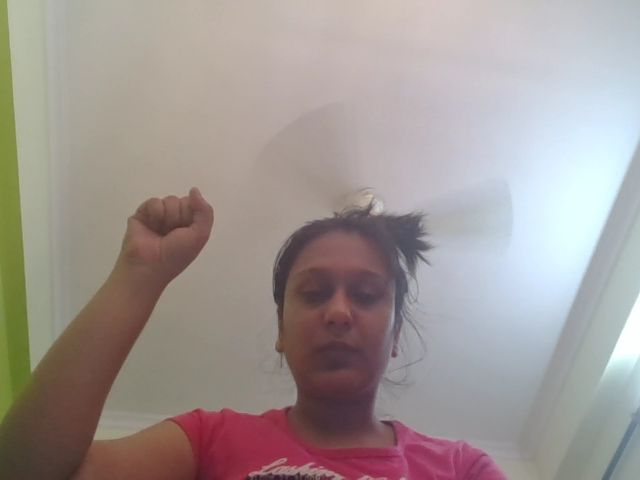

In [ ]:
from IPython.display import Image
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

In [ ]:

import imutils
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode
def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

In [ ]:
image_file = take_photo()

<IPython.core.display.Javascript object>

In [ ]:
image = cv2.imread(image_file)

# resize it to have a maximum width of 400 pixels
image = imutils.resize(image, width=400)
(h, w) = image.shape[:2]
print(w,h)
cv2_imshow(image)

NameError: ignored

In [ ]:
from IPython.display import display, Javascript, Image
from google.colab.output import eval_js
from base64 import b64decode, b64encode
import cv2
import numpy as np
import PIL
import io
import html
import time

In [ ]:
def js_to_image(js_reply):
  """
  Params:
          js_reply: JavaScript object containing image from webcam
  Returns:
          img: OpenCV BGR image
  """
  # decode base64 image
  image_bytes = b64decode(js_reply.split(',')[1])
  # convert bytes to numpy array
  jpg_as_np = np.frombuffer(image_bytes, dtype=np.uint8)
  # decode numpy array into OpenCV BGR image
  img = cv2.imdecode(jpg_as_np, flags=1)

  return img

# function to convert OpenCV Rectangle bounding box image into base64 byte string to be overlayed on video stream
def bbox_to_bytes(bbox_array):
  """
  Params:
          bbox_array: Numpy array (pixels) containing rectangle to overlay on video stream.
  Returns:
        bytes: Base64 image byte string
  """
  # convert array into PIL image
  bbox_PIL = PIL.Image.fromarray(bbox_array, 'RGBA')
  iobuf = io.BytesIO()
  # format bbox into png for return
  bbox_PIL.save(iobuf, format='png')
  # format return string
  bbox_bytes = 'data:image/png;base64,{}'.format((str(b64encode(iobuf.getvalue()), 'utf-8')))

  return bbox_bytes

In [ ]:
def video_stream():
  js = Javascript('''
    var video;
    var div = null;
    var stream;
    var captureCanvas;
    var imgElement;
    var labelElement;
    
    var pendingResolve = null;
    var shutdown = false;
    
    function removeDom() {
       stream.getVideoTracks()[0].stop();
       video.remove();
       div.remove();
       video = null;
       div = null;
       stream = null;
       imgElement = null;
       captureCanvas = null;
       labelElement = null;
    }
    
    function onAnimationFrame() {
      if (!shutdown) {
        window.requestAnimationFrame(onAnimationFrame);
      }
      if (pendingResolve) {
        var result = "";
        if (!shutdown) {
          captureCanvas.getContext('2d').drawImage(video, 0, 0, 640, 480);
          result = captureCanvas.toDataURL('image/jpeg', 0.8)
        }
        var lp = pendingResolve;
        pendingResolve = null;
        lp(result);
      }
    }
    
    async function createDom() {
      if (div !== null) {
        return stream;
      }

      div = document.createElement('div');
      div.style.border = '2px solid black';
      div.style.padding = '3px';
      div.style.width = '100%';
      div.style.maxWidth = '600px';
      document.body.appendChild(div);
      
      const modelOut = document.createElement('div');
      modelOut.innerHTML = "<span>Status:</span>";
      labelElement = document.createElement('span');
      labelElement.innerText = 'No data';
      labelElement.style.fontWeight = 'bold';
      modelOut.appendChild(labelElement);
      div.appendChild(modelOut);
           
      video = document.createElement('video');
      video.style.display = 'block';
      video.width = div.clientWidth - 6;
      video.setAttribute('playsinline', '');
      video.onclick = () => { shutdown = true; };
      stream = await navigator.mediaDevices.getUserMedia(
          {video: { facingMode: "environment"}});
      div.appendChild(video);

      imgElement = document.createElement('img');
      imgElement.style.position = 'absolute';
      imgElement.style.zIndex = 1;
      imgElement.onclick = () => { shutdown = true; };
      div.appendChild(imgElement);
      
      const instruction = document.createElement('div');
      instruction.innerHTML = 
          '<span style="color: red; font-weight: bold;">' +
          'When finished, click here or on the video to stop this demo</span>';
      div.appendChild(instruction);
      instruction.onclick = () => { shutdown = true; };
      
      video.srcObject = stream;
      await video.play();

      captureCanvas = document.createElement('canvas');
      captureCanvas.width = 640; //video.videoWidth;
      captureCanvas.height = 480; //video.videoHeight;
      window.requestAnimationFrame(onAnimationFrame);
      
      return stream;
    }
    async function stream_frame(label, imgData) {
      if (shutdown) {
        removeDom();
        shutdown = false;
        return '';
      }

      var preCreate = Date.now();
      stream = await createDom();
      
      var preShow = Date.now();
      if (label != "") {
        labelElement.innerHTML = label;
      }
            
      if (imgData != "") {
        var videoRect = video.getClientRects()[0];
        imgElement.style.top = videoRect.top + "px";
        imgElement.style.left = videoRect.left + "px";
        imgElement.style.width = videoRect.width + "px";
        imgElement.style.height = videoRect.height + "px";
        imgElement.src = imgData;
      }
      
      var preCapture = Date.now();
      var result = await new Promise(function(resolve, reject) {
        pendingResolve = resolve;
      });
      shutdown = false;
      
      return {'create': preShow - preCreate, 
              'show': preCapture - preShow, 
              'capture': Date.now() - preCapture,
              'img': result};
    }
    ''')

  display(js)
  
def video_frame(label, bbox):
  data = eval_js('stream_frame("{}", "{}")'.format(label, bbox))
  return data

<IPython.core.display.Javascript object>

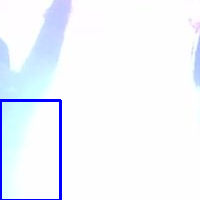

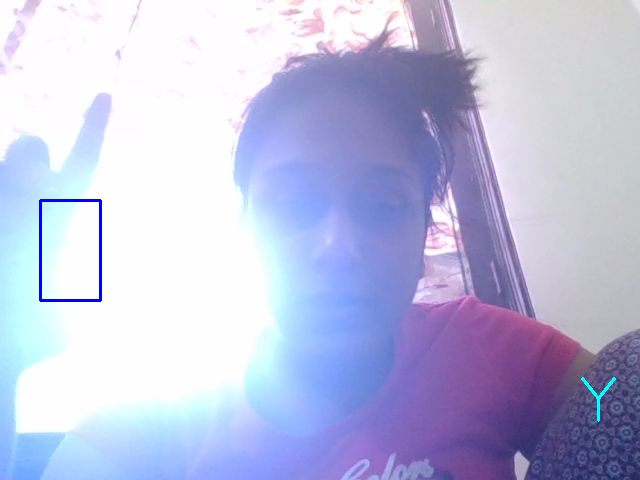

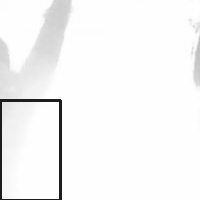

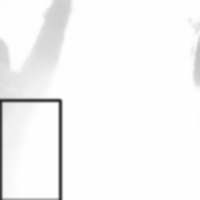

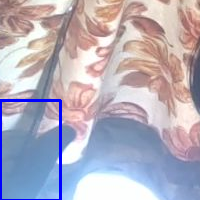

...

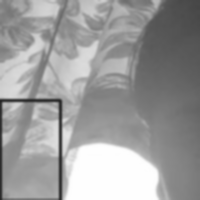

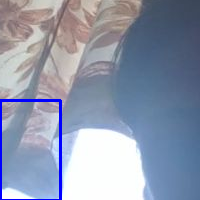

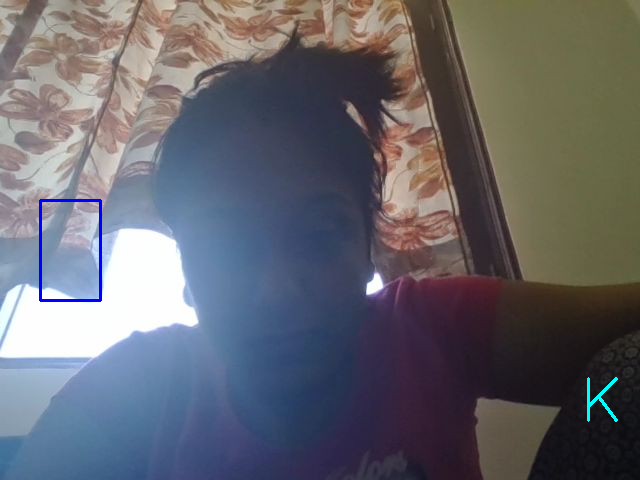

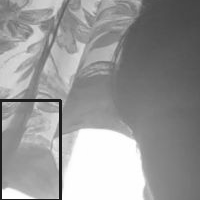

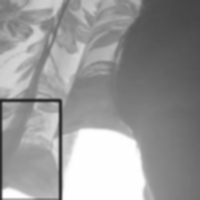

KeyboardInterrupt: ignored

In [ ]:
import numpy as np
import cv2
import tensorflow as tf
from google.colab.patches import cv2_imshow

model = tf.keras.models.load_model("/content/CNN_Model.h5")

def img_class(model, img):
    img_arr = np.asarray(img)
    
    pred_probab = model.predict(img_arr)[0]
    pred_class = list(pred_probab).index(max(pred_probab))
    return max(pred_probab), pred_class

video_stream()
# label for video
label_html = 'Capturing...'
# initialze bounding box to empty
bbox = ''

count = 0 
while True:
    js_reply = video_frame(label_html, bbox)
    if not js_reply:
        break

    # convert JS response to OpenCV Image
    img = js_to_image(js_reply["img"])
    img=cv2.rectangle(img,(100,300),(40,200),(255,0,0),2)

    crop=img[100:300, 40:240]
    cv2_imshow(crop)
    img_gry = cv2.cvtColor(crop, cv2.COLOR_BGR2GRAY)
    
    # Applying Gaussian BLur                       
    img_gry_blr = cv2.GaussianBlur(img_gry, (5,5), 0)
    
    # Resizing
    img_1 = cv2.resize(img_gry_blr, (28,28), interpolation = cv2.INTER_AREA)
    img_2 = np.resize(img_1, (28,28,1))
    img_3 = np.expand_dims(img_2, axis = 0)
    
        
    pred_probab, pred_class = img_class(model, img_3)
    
    char_op = chr(pred_class + 65)

    cv2.putText(img, char_op, (580,420), cv2.FONT_HERSHEY_SIMPLEX, 2, (255,255,0), 2)

    # Display the resulting frame
    cv2_imshow(img)
    cv2_imshow(img_gry)
    cv2_imshow(img_gry_blr)
    